https://arxiv.org/abs/1805.04340  
From the above paper, q-UCCSD cirquit is descrived as

\begin{equation}
\hat{U}(\vec{\theta}) 
= \prod_{i>j} \exp\left(\frac{i\theta^{(1)}_{ij}}{2} \; \hat{X}_i \; \left(\bigotimes_{a=j+1}^{i-1}\hat{Z}_a \right) \; \hat{Y}_j \right) \label{eq1}\tag{1} 
\end{equation}

\begin{equation}
\times \prod_{i>j} \exp\left(\frac{-i\theta^{(1)}_{ij}}{2} \; \hat{Y}_i \; \left(\bigotimes_{a=j+1}^{i-1}\hat{Z}_a \right) \; \hat{X}_j \right) \label{eq2}\tag{2}
\end{equation}

\begin{equation}
\times \prod_{i>j>k>l} \exp\left(\frac{i\theta^{(2)}_{ijkl}}{8} \; \hat{X}_i \; \left(\bigotimes_{a=j+1}^{i-1}\hat{Z}_a \right) \; \hat{Y}_j \; \hat{X}_k \; \left(\bigotimes_{b=l+1}^{k-1}\hat{Z}_b \right) \; \hat{X}_l \right) \label{eq3}\tag{3}
\end{equation}

\begin{equation}
\times \prod_{i>j>k>l} \exp\left(\frac{i\theta^{(2)}_{ijkl}}{8} \; \hat{Y}_i \; \left(\bigotimes_{a=j+1}^{i-1}\hat{Z}_a \right) \; \hat{Y}_j \; \hat{X}_k \; \left(\bigotimes_{b=l+1}^{k-1}\hat{Z}_b \right) \; \hat{Y}_l \right) \label{eq4}\tag{4}
\end{equation}

\begin{equation}
\times \prod_{i>j>k>l} \exp\left(\frac{i\theta^{(2)}_{ijkl}}{8} \; \hat{Y}_i \; \left(\bigotimes_{a=j+1}^{i-1}\hat{Z}_a \right) \; \hat{Y}_j \; \hat{Y}_k \; \left(\bigotimes_{b=l+1}^{k-1}\hat{Z}_b \right) \; \hat{X}_l \right) \label{eq5}\tag{5}
\end{equation}

\begin{equation}
\times \prod_{i>j>k>l} \exp\left(\frac{i\theta^{(2)}_{ijkl}}{8} \; \hat{Y}_i \; \left(\bigotimes_{a=j+1}^{i-1}\hat{Z}_a \right) \; \hat{X}_j \; \hat{X}_k \; \left(\bigotimes_{b=l+1}^{k-1}\hat{Z}_b \right) \; \hat{X}_l \right) \label{eq6}\tag{6}
\end{equation}

\begin{equation}
\times \prod_{i>j>k>l} \exp\left(\frac{-i\theta^{(2)}_{ijkl}}{8} \; \hat{X}_i \; \left(\bigotimes_{a=j+1}^{i-1}\hat{Z}_a \right) \; \hat{X}_j \; \hat{X}_k \; \left(\bigotimes_{b=l+1}^{k-1}\hat{Z}_b \right) \; \hat{Y}_l \right) \label{eq7}\tag{7}
\end{equation}

\begin{equation}
\times \prod_{i>j>k>l} \exp\left(\frac{-i\theta^{(2)}_{ijkl}}{8} \; \hat{X}_i \; \left(\bigotimes_{a=j+1}^{i-1}\hat{Z}_a \right) \; \hat{X}_j \; \hat{Y}_k \; \left(\bigotimes_{b=l+1}^{k-1}\hat{Z}_b \right) \; \hat{X}_l \right) \label{eq8}\tag{8}
\end{equation}

\begin{equation}
\times \prod_{i>j>k>l} \exp\left(\frac{-i\theta^{(2)}_{ijkl}}{8} \; \hat{X}_i \; \left(\bigotimes_{a=j+1}^{i-1}\hat{Z}_a \right) \; \hat{Y}_j \; \hat{Y}_k \; \left(\bigotimes_{b=l+1}^{k-1}\hat{Z}_b \right) \; \hat{Y}_l \right) \label{eq9}\tag{9}
\end{equation}

\begin{equation}
\times \prod_{i>j>k>l} \exp\left(\frac{-i\theta^{(2)}_{ijkl}}{8} \; \hat{Y}_i \; \left(\bigotimes_{a=j+1}^{i-1}\hat{Z}_a \right) \; \hat{X}_j \; \hat{Y}_k \; \left(\bigotimes_{b=l+1}^{k-1}\hat{Z}_b \right) \; \hat{Y}_l \right) \label{eq10}\tag{10}
\end{equation}


Here, $(\ref{eq1})$-$(\ref{eq2})$ and $(\ref{eq3})$-$(\ref{eq10})$ are corresponding to one-electron excitation, two-electron excitation, respectively.\
Note that pennylane (and quket) utilize the different definition above... (the coefficients in $\theta$ are different.)

# Setting for molecule and HF calculation

In [50]:
import os
os.environ["OPENBLAS_NUM_THREADS"] = "8"
os.environ["MKL_NUM_THREADS"] = "8"
os.environ["VECLIB_NUM_THREADS"] = "8"
os.environ["QULACS_NUM_THREADS"] = "8"

import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from openfermion.chem import MolecularData
from openfermion.transforms import get_fermion_operator, jordan_wigner, bravyi_kitaev
from openfermion.linalg import get_sparse_operator
from openfermion.ops import FermionOperator
from openfermionpyscf import run_pyscf
from pyscf import fci, mcscf
# equilibrium positional data from https://cccbdb.nist.gov/expgeom2x.asp
# ------------------------------------------------------
# xyz coordinates for atoms (angstrom)
dist = 4.0#1.3264
geometry = [("Be", (0.0, 0.0,  0.0)),
            ("H",  (0.0, 0.0,  dist)),
            ("H",  (0.0, 0.0, -dist))]
basis = "sto-3g"  #basis set
multiplicity = 3  #spin multiplicity 2S +1
charge = 0        #total charge for the molecule
# ------------------------------------------------------

molecule = MolecularData(geometry, basis, multiplicity, charge)
molecule = run_pyscf(molecule, run_scf=True, run_fci=False, run_ccsd=False, verbose=False)
print("HF energy: {} (Hartree)".format(molecule.hf_energy))
print("FCI energy: {} (Hartree)".format(molecule.fci_energy))

nele = molecule.n_electrons
norb = molecule.n_orbitals # number of spatial orbitals
nspinorb = nqubits = molecule.n_qubits # number of spin orbitals
print(f"nele = {nele}, norb = {norb}, nspinorb = nqubits = {nqubits}")

HF energy: -15.285062479854341 (Hartree)
FCI energy: None (Hartree)
nele = 6, norb = 7, nspinorb = nqubits = 14


# Visualization of MOs (Check D2h symmetry)
See the following URLs:  
https://www.andersle.no/posts/2022/mo/mo.html  
https://future-chem.com/py3dmol/  

In [22]:
# For visualization of molecules and orbitals:
import py3Dmol

# For plotting
import seaborn as sns
sns.set_theme(style="ticks", context="talk", palette="muted")

# For numerics:
import pandas as pd
pd.options.display.float_format = "{:,.3f}".format

In [55]:
# molecule._pyscf_data["scf"].analyze(verbose=5)
# print(molecule._pyscf_data["scf"].__dict__)
mol   = molecule._pyscf_data["mol"]
mf    = molecule._pyscf_data["scf"]
mo_occ_table = pd.DataFrame({"Energy": mf.mo_energy, "Occupancy": mf.mo_occ})
print(mo_occ_table)

   Energy  Occupancy
0  -4.484      2.000
1  -0.254      2.000
2  -0.080      1.000
3  -0.079      1.000
4   0.221      0.000
5   0.221      0.000
6   0.222      0.000


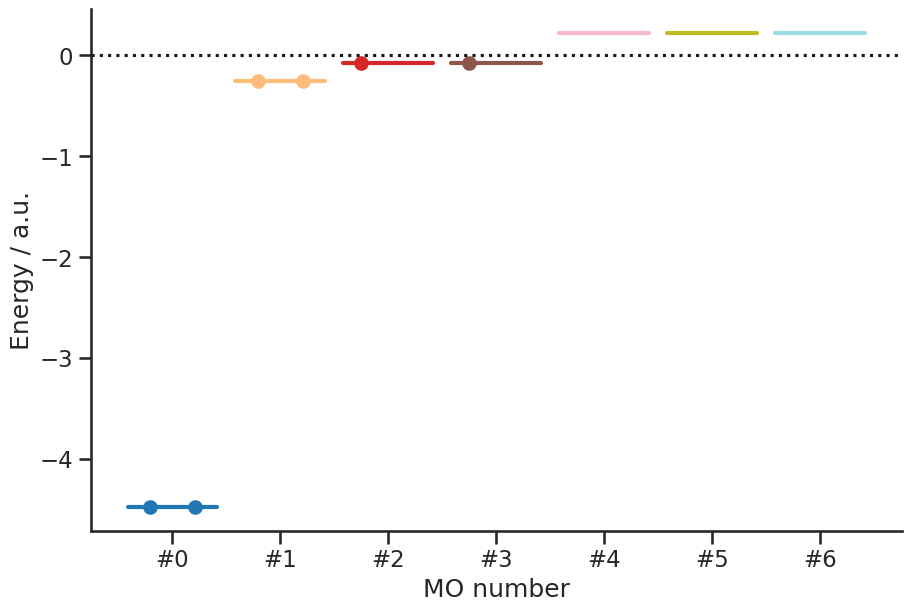

In [52]:
%matplotlib inline
fig, ax = plt.subplots(constrained_layout=True, figsize=(9, 6))
colors = matplotlib.cm.tab20(np.linspace(0, 1, len(mf.mo_energy))) # get_cmap() will be removed in Matplotlib 3.7

pos = []
for i, (energy, occ) in enumerate(zip(mf.mo_energy, mf.mo_occ)):
    left = 3 * i
    right = 3 * i + 2.5
    length = right - left

    (line,) = ax.plot([left, right], [energy, energy], color=colors[i], lw=3)

    electron_x, electron_y = None, None
    if occ == 2:
        electron_x = [left + 0.25 * length, left + 0.75 * length]
        electron_y = [energy, energy]
    elif occ == 1:
        electron_x, electron_y = [left + 0.5], [energy]
    if electron_x and electron_y:
        ax.scatter(electron_x, electron_y, color=line.get_color())

    pos.append(left + 0.5 * length)

ax.axhline(y=0, ls=":", color="k")
ax.set_xticks(pos)
ax.set_xticklabels([f"#{i}" for i, _ in enumerate(pos)])
ax.set(xlabel="MO number", ylabel="Energy / a.u.")
sns.despine(fig=fig)

In [25]:
import pathlib
from pyscf import tools
def write_all_coeffs(
    mol, coeffs, prefix="cmo", dirname=".", margin=5, offset=0
):
    """Write cube files for the given coefficients."""
    path = pathlib.Path(dirname)
    path.mkdir(parents=True, exist_ok=True)

    for i in range(coeffs.shape[1]):
        outfile = f"{prefix}_{i+offset:02d}.cube"
        outfile = path / outfile
        print(f"Writing {outfile}")
        tools.cubegen.orbital(mol, outfile, coeffs[:, i], margin=margin)

write_all_coeffs(mol, mf.mo_coeff, prefix=f"cmo", dirname="cmo", margin=5)

Writing cmo/cmo_00.cube
Writing cmo/cmo_01.cube
Writing cmo/cmo_02.cube
Writing cmo/cmo_03.cube
Writing cmo/cmo_04.cube
Writing cmo/cmo_05.cube
Writing cmo/cmo_06.cube


In [26]:
import py3Dmol
from pyscf import gto
mol_xyz = gto.mole.tostring(mol, format="xyz")
print(mol_xyz)

with open("cmo/cmo_06.cube", "r") as f:
    cube = f.read()

view = py3Dmol.view(width=300, height=300)
view.setBackgroundColor('#ebf4fb', viewer=(0,0))
### view.addModel(mol_xyz, "xyz") # Unnecessary
view.addModel(cube, "cube")
view.setStyle({'stick': {}, 'sphere': {'scale': 0.3}}, viewer=(0,0))
view.addVolumetricData(cube, "cube", {"isoval": 0.05, "smoothness":5, "opacity":0.6, "volformat":"cube", "color":"red"})
view.addVolumetricData(cube, "cube", {"isoval":-0.05, "smoothness":5, "opacity":0.6, "volformat":"cube", "color":"blue"})

view.zoomTo()
view.show()
#dist 1.0<= dist <=1.5   2.0<= dist <=4.0 for singlet and triplet multiplisity
#00:        ag                 ag  
#01:        ag                 ag  
#02:        b1u                b1u 
#03:        b2u                ag  
#04:        b3u                b2u 
#05:        ag                 b3u 
#06:        b1u                b1u 

3
XYZ from PySCF
Be          0.00000        0.00000        0.00000
H           0.00000        0.00000        4.00000
H           0.00000        0.00000       -4.00000


You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

In [27]:
view.png()

# JW conversion of Hamiltonian

In [57]:
from qulacs.observable import create_observable_from_openfermion_text

# Setting for active electron & spinorbitals
occ    = [0]          # spatial orbitals
active = [1,2,3,4,5,6]  # spatial orbitals 
nele = 4
nspinorb = nqubits = 12

jw_hamiltonian        = jordan_wigner(get_fermion_operator(molecule.get_molecular_hamiltonian(occupied_indices=occ,
                                                                                              active_indices  =active)))
#jw_hamiltonian        = jordan_wigner(get_fermion_operator(molecule.get_molecular_hamiltonian()))
qulacs_hamiltonian    = create_observable_from_openfermion_text(str(jw_hamiltonian))
jw_mat = get_sparse_operator(jw_hamiltonian)
# print(jw_hamiltonian)
# print(qulacs_hamiltonian.get_term(0).get_coef())
# print(qulacs_hamiltonian.get_term(0).get_pauli_id_list())
# print(qulacs_hamiltonian.get_term(0).get_index_list())

# Definition of initial state
1, 0 are corresponding to occupied orbital, virtual orbital, respectively.\
Note that when using QuantumState or get_expectation_value, qubits are described by rotation it 90º counterclockwise.\
For example, |000011> is described as\
1 (occ)\
1 (occ)\
0 (virt)\
0 (virt)\
0 (virt)\
0 (virt)

In [58]:
import numpy as np
from qulacs import QuantumState
from qulacs import QuantumCircuit

print(mf.mo_occ)


# def create_hf_state(nele, nspinorb):
#     state = QuantumState(nqubits)
#     state.set_zero_state()
#     hf_state_bin = "0b" +"0" *(nspinorb -nele) +"1" *nele 
#     state.set_computational_basis(int(hf_state_bin, 0))

#     return state

def create_active_hf_state(mo_occ, nele, nqubits, print_state=None):
    hf_state_bin = ""
    ncore_orb = int(np.sum(mo_occ) - nele) //2
    count_ncore_orb = 0  # spatial orb
    count_nqubits = 0
    for occ in mo_occ:
        if count_nqubits < nqubits +ncore_orb *2:
            count_nqubits += 2
        else:
            break

        if count_ncore_orb < ncore_orb:
            count_ncore_orb += 1
            continue    
            
        if int(occ) == 0:
            hf_state_bin += "00"
        elif int(occ) == 1:
            hf_state_bin += "10"  # considered as alpha spin
        elif int(occ) == 2:
            hf_state_bin += "11"
        else:
            raise ValueError("Invalid occ number detected!!!")
 
    hf_state_bin = hf_state_bin[::-1]
    hf_state_bin = "0b" + hf_state_bin
    state = QuantumState(nqubits)
    state.set_zero_state()
    state.set_computational_basis(int(hf_state_bin, 0))
    if print_state:
        print(f"HF state in binary = {hf_state_bin}, where 1 is occ, 0 is unocc, and consider this by rotating it 90º counterclockwise!")
        return state, hf_state_bin

    return state
    

# Create HF state
hf_state, hf_state_bin = create_active_hf_state(mf.mo_occ, nele, nspinorb, print_state=True)
# Check HF energy
hf_ene = qulacs_hamiltonian.get_expectation_value(hf_state)

def kron_N(hf_state_bin):
    hf_state_bin = hf_state_bin[2:]    # 0b0011 -> 0011
    hf_state_bin = hf_state_bin[::-1]  #   0011 -> 1100  
    bra0 = np.array([[1,0]])
    bra1 = np.array([[0,1]])
    tmp = bra1 if hf_state_bin[0] == "1" else bra0
    for i in hf_state_bin[1:]:
        op = bra1 if i == "1" else bra0
        tmp = np.kron(tmp, op)
    return tmp

HFbra = kron_N(hf_state_bin)
HFket = HFbra.T
jw_matrix = get_sparse_operator(jw_hamiltonian)
hf_ene_from_mat = np.real(HFbra.dot(jw_matrix.dot(HFket)))[0][0]
print(f"Check HF energy:\n"
      f" pyscf           = {molecule.hf_energy:14.10f}\n"
      f" qulacs          = {hf_ene:14.10f}\n"
      f" hf_ene_from_mat = {hf_ene_from_mat:14.10f}")

eigenenergies, eigenvecs = np.linalg.eigh(jw_matrix.toarray().real)

def decode_to_state(eigenvec, threshold=1e-6):
    bit_vec = np.where(eigenvec > threshold, True, False)
    digit = 0
    length = len(eigenvec)
    while length != 1:
        digit += 1
        length //= 2
    op = False
    for indx, bit in enumerate(bit_vec):
        if bit:
            op_str = "      +" if op else "|Psi> =" 
            config = str(bin(indx))[2:]
            config = "0" *(digit -len(config)) +config
            print(f"{op_str} {eigenvec[indx]:14.10f} |{config}>")
            op = True

    return None

def decode_to_states(eigenenergies, eigenvecs, states=[0]):
    for istate in states:
        print(f"\n\n=== Electronic Configuration: {istate} ===\n")
        print(f"Energy: {eigenenergies[istate]} [Eh]")
        decode_to_state(eigenvecs[:,istate])
 
    return None


decode_to_states(eigenenergies, eigenvecs, list(range(1)))

print("\n\n=== CASCI Result ===\n")
mycas = mcscf.CASCI(mf, 6, (2, 2))  # alpha=2, beta=2 in 6 spatial orbitals
casci = mycas.kernel(verbose=False)
print(casci[0])

[2. 2. 1. 1. 0. 0. 0.]
HF state in binary = 0b000000010111, where 1 is occ, 0 is unocc, and consider this by rotating it 90º counterclockwise!
Check HF energy:
 pyscf           = -15.2850624799
 qulacs          = -15.2850624799
 hf_ene_from_mat = -15.2850624799


=== Electronic Configuration: 0 ===

Energy: -15.336494845573707 [Eh]
|Psi> =   0.0000645484 |001000001101>
      +   0.0000645484 |001000110001>
      +   0.0064998466 |001011000001>
      +   0.1319306701 |001100000011>
      +   0.1322597506 |001100001100>
      +   0.1322597506 |001100110000>
      +   0.0039553221 |010010000011>
      +   0.0042070636 |010010001100>
      +   0.0042070636 |010010110000>
      +   0.0023023103 |011010000001>
      +   0.0023023103 |100101000010>
      +   0.0012645445 |101101000000>
      +   0.6684373586 |110011000000>
      +   0.0002265487 |110100000010>


=== CASCI Result ===

CASCI E = -15.3364948455737  E(CI) = -2.49215094140526  S^2 = 0.0000000
-15.336494845573696


# 励起状態の行列式生成

In [30]:
from itertools import combinations as comb
from itertools import product as prod

def create_excitations(hf_state_bin, delta_sz_from_hf_state):
    hf_state_bin = hf_state_bin[2:]    # 0b0011 -> 0011
    hf_state_bin = hf_state_bin[::-1]  #   0011 -> 1100  

    sz_list = np.array([+1/2 if (i %2 == 0) else -1/2 for i in range(len(hf_state_bin))])
    spinocc_list  = np.array([i for i, val in enumerate(hf_state_bin) if val == "1"])  
    print(spinocc_list)
    spinvirt_list  = np.array([i for i, val in enumerate(hf_state_bin) if val == "0"])  
    print(spinvirt_list)
    singles = [sorted([r, p])  # i>jの並べ替え
               for r, p in list(prod(spinocc_list, spinvirt_list))
               if (sz_list[p] -sz_list[r] == delta_sz_from_hf_state)]
    
    spinocc_comb  = list(comb(spinocc_list, 2))
    spinvirt_comb = list(comb(spinvirt_list, 2))
    
    doubles = [sorted([s, r, q, p])  # i>j>k>lの並べ替え
               for (s, r), (q, p) in list(prod(spinocc_comb, spinvirt_comb))
               if (sz_list[p] +sz_list[q] -sz_list[r] -sz_list[s] == delta_sz_from_hf_state)]
    
    return singles, doubles

In [31]:
delta_sz_from_hf_state = -1  # select from -2, -1, 0, 1, 2 at the moment 
#hf_state_bin = "0b000000010111"
singles, doubles = create_excitations(hf_state_bin, delta_sz_from_hf_state)
print(f"singles = {singles}\n\ndoubles = {doubles}")

[0 1 2 4]
[ 3  5  6  7  8  9 10 11]
singles = [[0, 3], [0, 5], [0, 7], [0, 9], [0, 11], [2, 3], [2, 5], [2, 7], [2, 9], [2, 11], [3, 4], [4, 5], [4, 7], [4, 9], [4, 11]]

doubles = [[0, 1, 3, 5], [0, 1, 3, 7], [0, 1, 3, 9], [0, 1, 3, 11], [0, 1, 5, 7], [0, 1, 5, 9], [0, 1, 5, 11], [0, 1, 7, 9], [0, 1, 7, 11], [0, 1, 9, 11], [0, 2, 3, 6], [0, 2, 3, 8], [0, 2, 3, 10], [0, 2, 5, 6], [0, 2, 5, 8], [0, 2, 5, 10], [0, 2, 6, 7], [0, 2, 6, 9], [0, 2, 6, 11], [0, 2, 7, 8], [0, 2, 7, 10], [0, 2, 8, 9], [0, 2, 8, 11], [0, 2, 9, 10], [0, 2, 10, 11], [0, 3, 4, 6], [0, 3, 4, 8], [0, 3, 4, 10], [0, 4, 5, 6], [0, 4, 5, 8], [0, 4, 5, 10], [0, 4, 6, 7], [0, 4, 6, 9], [0, 4, 6, 11], [0, 4, 7, 8], [0, 4, 7, 10], [0, 4, 8, 9], [0, 4, 8, 11], [0, 4, 9, 10], [0, 4, 10, 11], [1, 2, 3, 5], [1, 2, 3, 7], [1, 2, 3, 9], [1, 2, 3, 11], [1, 2, 5, 7], [1, 2, 5, 9], [1, 2, 5, 11], [1, 2, 7, 9], [1, 2, 7, 11], [1, 2, 9, 11], [1, 3, 4, 5], [1, 3, 4, 7], [1, 3, 4, 9], [1, 3, 4, 11], [1, 4, 5, 7], [1, 4, 5, 9], [1, 4, 5,

# Reduction of excitation operators by usng D2h symmetry
see https://ja.webqc.org/symmetrypointgroup-d2h.html

In [32]:
D2h = [["ag",  "b1g", "b2g", "b3g", "au",  "b1u", "b2u", "b3u"],
       ["b1g", "ag",  "b3g", "b2g", "b1u", "au",  "b3u", "b2u"],
       ["b2g", "b3g", "ag",  "b1g", "b2u", "b3u", "au",  "b1u"],
       ["b3g", "b2g", "b1g", "ag",  "b3u", "b2u", "b1u", "au" ],
       ["au",  "b1u", "b2u", "b3u", "ag",  "b1g", "b2g", "b3g"],
       ["b1u", "au",  "b3u", "b2u", "b1g", "ag",  "b3g", "b2g"],
       ["b2u", "b3u", "au",  "b1u", "b2g", "b3g", "ag",  "b1g"],
       ["b3u", "b2u", "b1u", "au",  "b3g", "b2g", "b1g", "ag" ]]
D2h_table = pd.DataFrame(D2h, 
                         index=["ag", "b1g", "b2g", "b3g", "au", "b1u", "b2u", "b3u"], 
                         columns=["ag", "b1g", "b2g", "b3g", "au", "b1u", "b2u", "b3u"])
print(D2h_table)
#dist <=1.5   2.0>=
#00:  ag      ag     -> Not active
#01:  ag      ag
#02:  b1u     b1u
#03:  b2u     ag
#04:  b3u     b2u
#05:  ag      b3u
#06:  b1u     b1u

if dist <= 1.5:
    active_orb_sym = ["ag", "b1u", "b2u", "b3u", "ag", "b1u"]
elif dist >= 2.0:
    active_orb_sym = ["ag", "b1u", "ag",  "b2u", "b3u", "b1u"] 
else:
    raise ValueError("Invalid dist detected!")
    
    
def judge_initial_sym(active_orb_sym, hf_state_bin, D2h_table):
    hf_state_bin = hf_state_bin[2:]    # 0b0011 -> 0011
    hf_state_bin = hf_state_bin[::-1]  #   0011 -> 1100    
    initial_sym = "ag"  # just for the temporary symmetry for initailization
    
    for indx, val in enumerate(hf_state_bin):
        if val == "1":
            initial_sym = D2h_table.loc[initial_sym, active_orb_sym[indx //2]]
    return initial_sym
    
def judge_D2h_excitation(singles, doubles, active_orb_sym, initial_sym, D2h_table):
    new_singles = []
    new_doubles = []
    for excitation in singles:
        sym = initial_sym
        for indx in excitation:
            sym = D2h_table.loc[sym, active_orb_sym[indx //2]]
        if sym == "ag":  # because target ground state symmetry is "ag"
            new_singles.append(excitation)

    for excitation in doubles:
        sym = initial_sym
        for indx in excitation:
            sym = D2h_table.loc[sym, active_orb_sym[indx //2]]
        if sym == "ag":  # because target ground state symmetry is "ag"
            new_doubles.append(excitation)
            
    return new_singles, new_doubles
            
        
initial_sym = judge_initial_sym(active_orb_sym, hf_state_bin, D2h_table)
print(f"\ninitial state symmetry = {initial_sym}")
singles, doubles = judge_D2h_excitation(singles, doubles, active_orb_sym, initial_sym, D2h_table)
print(f"singles = {singles}\n\ndoubles = {doubles}")

      ag  b1g  b2g  b3g   au  b1u  b2u  b3u
ag    ag  b1g  b2g  b3g   au  b1u  b2u  b3u
b1g  b1g   ag  b3g  b2g  b1u   au  b3u  b2u
b2g  b2g  b3g   ag  b1g  b2u  b3u   au  b1u
b3g  b3g  b2g  b1g   ag  b3u  b2u  b1u   au
au    au  b1u  b2u  b3u   ag  b1g  b2g  b3g
b1u  b1u   au  b3u  b2u  b1g   ag  b3g  b2g
b2u  b2u  b3u   au  b1u  b2g  b3g   ag  b1g
b3u  b3u  b2u  b1u   au  b3g  b2g  b1g   ag

initial state symmetry = b1u
singles = [[0, 3], [0, 11], [2, 5], [3, 4], [4, 11]]

doubles = [[0, 1, 3, 5], [0, 1, 5, 11], [0, 2, 3, 10], [0, 2, 6, 7], [0, 2, 8, 9], [0, 2, 10, 11], [0, 4, 5, 10], [1, 2, 3, 11], [1, 3, 4, 5], [1, 4, 5, 11], [2, 3, 4, 10], [2, 4, 6, 7], [2, 4, 8, 9], [2, 4, 10, 11]]


# Create quantum cirquit for one-electron excitation (q-UCCS)

In [33]:
from math import pi
from qulacs.gate import H, RX
import re

def t1_circuit(param, r, p, pauli_list, cnot_connects, circuit): # Eq. (1)-(2)
    assert re.search("[^XY]", pauli_list) == None, "pauli matrices X or Y are acceptable."
    
    gate_r1 = H(r) if pauli_list[0] == "X" else RX(r, pi/2) # else is "Y"
    gate_p1 = H(p) if pauli_list[1] == "X" else RX(p, pi/2)

    circuit.add_gate(gate_r1)
    circuit.add_gate(gate_p1)
    
    for cnot_connect in cnot_connects:
        circuit.add_CNOT_gate(cnot_connect[0], cnot_connect[1]) # control, target
    
    circuit.add_RZ_gate(p, param)

    for cnot_connect in reversed(cnot_connects):
        circuit.add_CNOT_gate(cnot_connect[0], cnot_connect[1]) # control, target

    gate_r2 = H(r) if pauli_list[0] == "X" else RX(r, -pi/2) # else is "Y"
    gate_p2 = H(p) if pauli_list[1] == "X" else RX(p, -pi/2)

    circuit.add_gate(gate_p2)
    circuit.add_gate(gate_r2)

    return None



def add_fermionic_single(param, single, circuit): # only 1 parameter
    # Excitation r -> p
    r = single[0]
    p = single[1]
    
    cnot_connects = [[i, i+1] for i in range(r, p)]
    
    # paramの定義がpennylaneと異なる
    t1_circuit(-param, r, p, "YX", cnot_connects, circuit) # Eq. (1)
    t1_circuit( param, r, p, "XY", cnot_connects, circuit) # Eq. (2)

    return None

# Create quantum cirquit for two-electron excitation (q-UCCD)

In [34]:
from math import pi
from qulacs.gate import H, RX
import re

def t2_circuit(param, s, r, q, p, pauli_list, cnot_connects, circuit): # Eq. (3)-(10)
    assert re.search("[^XY]", pauli_list) == None, "pauli matrices X or Y are acceptable."

    gate_s1 = H(s) if pauli_list[0] == "X" else RX(s, pi/2) # else is "Y"
    gate_r1 = H(r) if pauli_list[1] == "X" else RX(r, pi/2)
    gate_q1 = H(q) if pauli_list[2] == "X" else RX(q, pi/2)
    gate_p1 = H(p) if pauli_list[3] == "X" else RX(p, pi/2)
    
    circuit.add_gate(gate_s1)
    circuit.add_gate(gate_r1)
    circuit.add_gate(gate_q1)
    circuit.add_gate(gate_p1)
    
    for cnot_connect in cnot_connects:
        circuit.add_CNOT_gate(cnot_connect[0], cnot_connect[1]) # control, target
    
    circuit.add_RZ_gate(p, param)

    for cnot_connect in reversed(cnot_connects):
        circuit.add_CNOT_gate(cnot_connect[0], cnot_connect[1]) # control, target

    gate_s2 = H(s) if pauli_list[0] == "X" else RX(s, -pi/2) # else is "Y"
    gate_r2 = H(r) if pauli_list[1] == "X" else RX(r, -pi/2)
    gate_q2 = H(q) if pauli_list[2] == "X" else RX(q, -pi/2)
    gate_p2 = H(p) if pauli_list[3] == "X" else RX(p, -pi/2)
    
    circuit.add_gate(gate_p2)
    circuit.add_gate(gate_q2)
    circuit.add_gate(gate_r2)
    circuit.add_gate(gate_s2)
    
    return None



def add_fermionic_double(param, double, circuit): # only 1 parameter
    # Excitation s,r -> q,p
    s = double[0]
    r = double[1]
    q = double[2]
    p = double[3]
    
    cnot_occ =  [[i, i+1] for i in range(s, r)]
    cnot_virt = [[i, i+1] for i in range(q, p)]
    cnot_connects = cnot_occ +[[r, q]] +cnot_virt
    
    # paramの定義がpennylaneと異なる
    t2_circuit(-param/4.0, s, r, q, p, "XXYX", cnot_connects, circuit) # Eq. (3)
    t2_circuit(-param/4.0, s, r, q, p, "YXYY", cnot_connects, circuit) # Eq. (4)
    t2_circuit(-param/4.0, s, r, q, p, "XYYY", cnot_connects, circuit) # Eq. (5)
    t2_circuit(-param/4.0, s, r, q, p, "XXXY", cnot_connects, circuit) # Eq. (6)
    t2_circuit( param/4.0, s, r, q, p, "YXXX", cnot_connects, circuit) # Eq. (7)
    t2_circuit( param/4.0, s, r, q, p, "XYXX", cnot_connects, circuit) # Eq. (8)
    t2_circuit( param/4.0, s, r, q, p, "YYYX", cnot_connects, circuit) # Eq. (9)
    t2_circuit( param/4.0, s, r, q, p, "YYXY", cnot_connects, circuit) # Eq. (10)

    return None

# Create quantum cirquit for q-UCCSD

In [35]:
def UCCSD_circuit(params, singles=None, doubles=None):
    circuit = QuantumCircuit(nqubits)
    if singles != None:
        for idx, single in enumerate(singles):
            add_fermionic_single(params[idx], single, circuit)
    if doubles != None:
        for idx, double in enumerate(doubles):
            add_fermionic_double(params[idx +len(singles)], double, circuit) # t2パラメータはt1パラメータの後ろに設定
    
    return circuit

In [77]:
def compute_energy(params): # singles, doubles, state are working as global variables 
    hf_state = create_active_hf_state(np.array([2., 2., 1., 1., 0., 0., 0.]), nele, nqubits)  # HF state initialization each time  
    #hf_state = create_active_hf_state(np.array([2., 2., 2., 0., 0., 0., 0.]), nele, nqubits)  
    #hf_state = create_active_hf_state(mf.mo_occ, nele, nqubits)           
    circuit = UCCSD_circuit(params, singles=singles, doubles=doubles)  # create quantum cirquit 
    circuit.update_quantum_state(hf_state)                             # apply quantum cirquit to state
   
    return qulacs_hamiltonian.get_expectation_value(hf_state)
print(mf.mo_occ)

[2. 2. 1. 1. 0. 0. 0.]


In [65]:
from scipy.optimize import minimize

ene_hist = []
#params = np.zeros(len(singles +doubles)) 
#params = np.full(len(singles +doubles), 1.0) 
params = np.random.normal(0, np.pi, len(singles +doubles)) 
ene_hist.append(compute_energy(params))

method = "BFGS"
options = {"disp": True, "maxiter": 1000, "gtol": 1e-10}

#method = "COBYLA"
#options = None

opt = minimize(compute_energy, 
               params,
               method=method,
               callback=lambda params: ene_hist.append(compute_energy(params)),
               options=options,
               jac="2-point",
               tol=1e-10) 

         Current function value: -15.285087
         Iterations: 297
         Function evaluations: 9814
         Gradient evaluations: 490


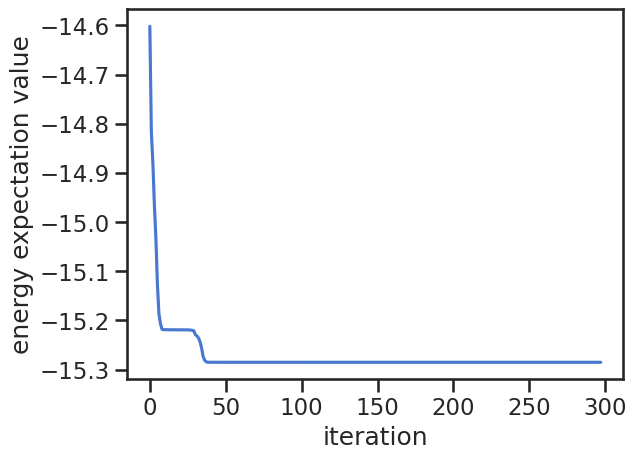

-15.285086713766706
[ 3.141688   -3.14152349 -1.56490321  4.71222496  5.47480105  3.37121073
  1.51015909  2.55443423  4.27946431 -4.24028027 -1.21223125 -4.89219815
  2.4965485   0.08896325 -5.42055983 -3.1950627  -2.52523875  0.8612661
  1.13847173]


In [78]:
plt.plot(ene_hist)
plt.xlabel("iteration")
plt.ylabel("energy expectation value")
plt.show()
print(compute_energy(opt.x))
print(opt.x)  # final parameter